![for sale image, from https://time.com/5835778/selling-home-coronavirus/](https://api.time.com/wp-content/uploads/2020/05/selling-home-coronavirus.jpg?w=800&quality=85)

# Project Title

## Overview

A one-paragraph overview of the project, including the business problem, data, methods, results and recommendations.

## Business Problem

Summary of the business problem you are trying to solve, and the data questions that you plan to answer to solve them.

Questions to consider:

- Who are your stakeholders?
- What are your stakeholders' pain points related to this project?
- Why are your predictions important from a business perspective?

## Data Understanding

Describe the data being used for this project.

Questions to consider:

- Where did the data come from, and how do they relate to the data analysis questions?
- What do the data represent? Who is in the sample and what variables are included?
- What is the target variable?
- What are the properties of the variables you intend to use?

In [76]:
!ls ../../data

Untitled.ipynb
Zipcodes_for_King_County_and_Surrounding_Area___zipcode_area.geojson
column_names.md
kc_house_data.csv


In [2]:
# code here to explore your data


import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

from datetime import datetime

from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_validate
from statsmodels.formula.api import ols
import statsmodels.api as sm
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.datasets import make_regression
from sklearn.linear_model import LinearRegression
import sklearn.metrics as metrics
from random import gauss
from mpl_toolkits.mplot3d import Axes3D
from scipy import stats as stats





df = pd.read_csv('../../data/kc_house_data.csv')


In [3]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,NONE,...,7 Average,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,NO,NONE,...,7 Average,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,NO,NONE,...,6 Low Average,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,NO,NONE,...,7 Average,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,NO,NONE,...,8 Good,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503


In [4]:
df.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15'],
      dtype='object')

In [5]:
df.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.159700e+04,2.159700e+04,21597.000000,21597.000000,21597.000000,2.159700e+04,21597.000000,21597.000000,21597.000000,17755.000000,21597.000000,21597.000000,21597.000000,21597.000000,21597.000000
mean,4.580474e+09,5.402966e+05,3.373200,2.115826,2080.321850,1.509941e+04,1.494096,1788.596842,1970.999676,83.636778,98077.951845,47.560093,-122.213982,1986.620318,12758.283512
std,2.876736e+09,3.673681e+05,0.926299,0.768984,918.106125,4.141264e+04,0.539683,827.759761,29.375234,399.946414,53.513072,0.138552,0.140724,685.230472,27274.441950
min,1.000102e+06,7.800000e+04,1.000000,0.500000,370.000000,5.200000e+02,1.000000,370.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.220000e+05,3.000000,1.750000,1430.000000,5.040000e+03,1.000000,1190.000000,1951.000000,0.000000,98033.000000,47.471100,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,1560.000000,1975.000000,0.000000,98065.000000,47.571800,-122.231000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068500e+04,2.000000,2210.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,9410.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     19221 non-null  object 
 9   view           21534 non-null  object 
 10  condition      21597 non-null  object 
 11  grade          21597 non-null  object 
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  object 
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   17755 non-null  float64
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

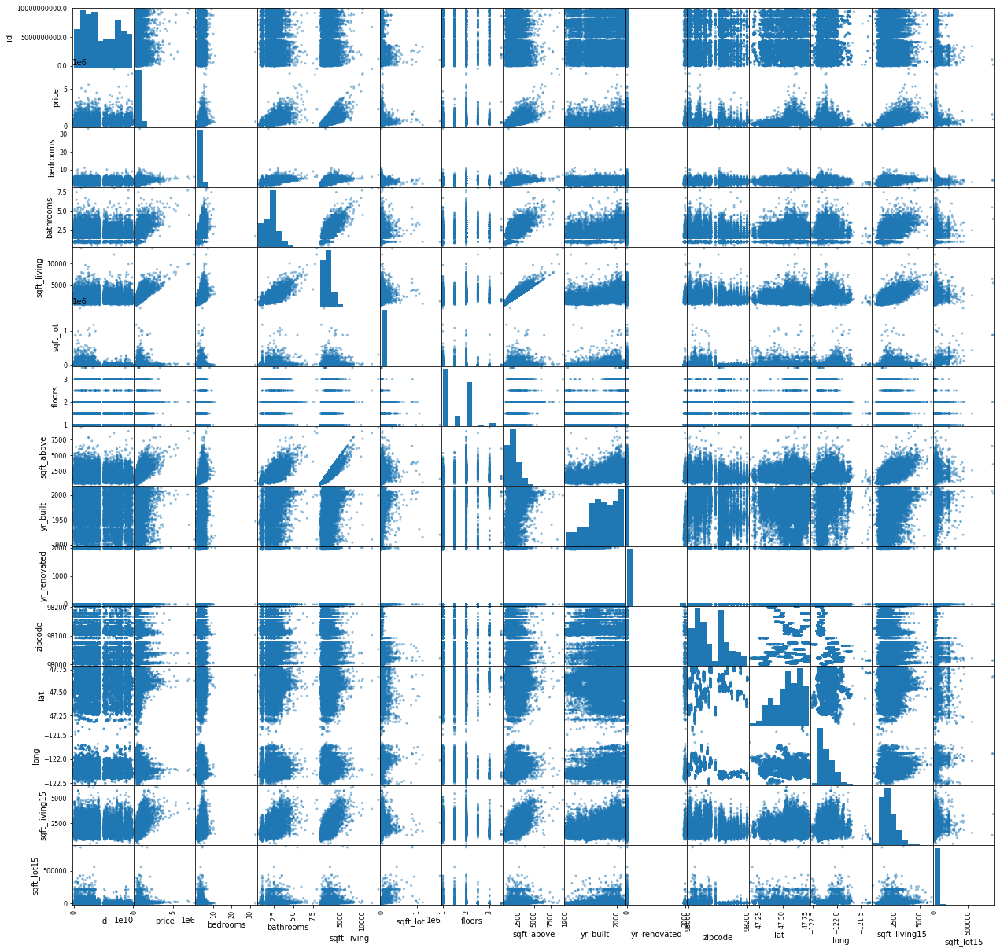

In [7]:
pd.plotting.scatter_matrix(df, figsize = [21,21]);
plt.show()

In [8]:
df.corr()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
id,1.000000,-0.016772,0.001150,0.005162,-0.012241,-0.131911,0.018608,-0.010799,0.021617,-0.012010,-0.008211,-0.001798,0.020672,-0.002701,-0.138557
price,-0.016772,1.000000,0.308787,0.525906,0.701917,0.089876,0.256804,0.605368,0.053953,0.129599,-0.053402,0.306692,0.022036,0.585241,0.082845
bedrooms,0.001150,0.308787,1.000000,0.514508,0.578212,0.032471,0.177944,0.479386,0.155670,0.018495,-0.154092,-0.009951,0.132054,0.393406,0.030690
bathrooms,0.005162,0.525906,0.514508,1.000000,0.755758,0.088373,0.502582,0.686668,0.507173,0.051050,-0.204786,0.024280,0.224903,0.569884,0.088303
sqft_living,-0.012241,0.701917,0.578212,0.755758,1.000000,0.173453,0.353953,0.876448,0.318152,0.055660,-0.199802,0.052155,0.241214,0.756402,0.184342
sqft_lot,-0.131911,0.089876,0.032471,0.088373,0.173453,1.000000,-0.004814,0.184139,0.052946,0.004513,-0.129586,-0.085514,0.230227,0.144763,0.718204
floors,0.018608,0.256804,0.177944,0.502582,0.353953,-0.004814,1.000000,0.523989,0.489193,0.003535,-0.059541,0.049239,0.125943,0.280102,-0.010722
sqft_above,-0.010799,0.605368,0.479386,0.686668,0.876448,0.184139,0.523989,1.000000,0.424037,0.022137,-0.261570,-0.001199,0.344842,0.731767,0.195077
yr_built,0.021617,0.053953,0.155670,0.507173,0.318152,0.052946,0.489193,0.424037,1.000000,-0.225209,-0.347210,-0.148370,0.409993,0.326377,0.070777
yr_renovated,-0.012010,0.129599,0.018495,0.051050,0.055660,0.004513,0.003535,0.022137,-0.225209,1.000000,0.069846,0.032145,-0.072156,-0.000247,0.003852


In [9]:
df['waterfront'].value_counts()

NO     19075
YES      146
Name: waterfront, dtype: int64

In [10]:
df['view'].value_counts()

NONE         19422
AVERAGE        957
GOOD           508
FAIR           330
EXCELLENT      317
Name: view, dtype: int64

In [11]:
df['grade'].value_counts()

7 Average        8974
8 Good           6065
9 Better         2615
6 Low Average    2038
10 Very Good     1134
11 Excellent      399
5 Fair            242
12 Luxury          89
4 Low              27
13 Mansion         13
3 Poor              1
Name: grade, dtype: int64

In [12]:
df['sqft_basement'].value_counts()

0.0       12826
?           454
600.0       217
500.0       209
700.0       208
          ...  
243.0         1
3260.0        1
588.0         1
704.0         1
2350.0        1
Name: sqft_basement, Length: 304, dtype: int64

In [13]:
df['zipcode'].value_counts()

98103    602
98038    589
98115    583
98052    574
98117    553
        ... 
98102    104
98010    100
98024     80
98148     57
98039     50
Name: zipcode, Length: 70, dtype: int64

In [14]:
df['date'].describe()

count         21597
unique          372
top       6/23/2014
freq            142
Name: date, dtype: object

In [15]:
df['condition'].value_counts()

Average      14020
Good          5677
Very Good     1701
Fair           170
Poor            29
Name: condition, dtype: int64

In [16]:
df['date'] = pd.to_datetime(df['date'])


In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             21597 non-null  int64         
 1   date           21597 non-null  datetime64[ns]
 2   price          21597 non-null  float64       
 3   bedrooms       21597 non-null  int64         
 4   bathrooms      21597 non-null  float64       
 5   sqft_living    21597 non-null  int64         
 6   sqft_lot       21597 non-null  int64         
 7   floors         21597 non-null  float64       
 8   waterfront     19221 non-null  object        
 9   view           21534 non-null  object        
 10  condition      21597 non-null  object        
 11  grade          21597 non-null  object        
 12  sqft_above     21597 non-null  int64         
 13  sqft_basement  21597 non-null  object        
 14  yr_built       21597 non-null  int64         
 15  yr_renovated   1775

In [18]:
df['date'].value_counts()

2014-06-23    142
2014-06-25    131
2014-06-26    131
2014-07-08    127
2015-04-27    126
             ... 
2014-07-27      1
2015-03-08      1
2014-11-02      1
2015-05-15      1
2015-05-24      1
Name: date, Length: 372, dtype: int64

In [19]:
df['date'].min()

Timestamp('2014-05-02 00:00:00')

In [20]:
df['date'].max()

Timestamp('2015-05-27 00:00:00')

In [21]:
test = df['sqft_basement'].replace('?','0')

In [22]:
test.head()

0      0.0
1    400.0
2      0.0
3    910.0
4      0.0
Name: sqft_basement, dtype: object

In [23]:
df['sqft_basement'].value_counts()

0.0       12826
?           454
600.0       217
500.0       209
700.0       208
          ...  
243.0         1
3260.0        1
588.0         1
704.0         1
2350.0        1
Name: sqft_basement, Length: 304, dtype: int64

In [ ]:
df['']

In [24]:
df['test_basement'] = df['sqft_living'] - df['sqft_above']
df[['test_basement', 'sqft_basement']]


,test_basement,sqft_basement
0,0,0.0
1,400,400.0
2,0,0.0
3,910,910.0
4,0,0.0
...,...,...
21592,0,0.0
21593,0,0.0
21594,0,0.0
21595,0,0.0


In [25]:
df['sqft_basement'] = df['test_basement']

In [26]:
df_limited = df.drop(columns = ['id', 'waterfront', 'view', 'yr_renovated'])

In [27]:
df_limited['test_basement'] = df['sqft_living'] - df['sqft_above']

In [28]:
condition_df = df_limited[["condition"]]

ohe = OneHotEncoder(categories="auto",sparse= False, handle_unknown="ignore")

ohe.fit(condition_df)

ohe.categories_

transformed_condition = ohe.transform(condition_df)
transformed_condition = pd.DataFrame(transformed_condition, columns = ohe.categories_[0], index= df_limited.index)

transformed_condition

df_limited.drop("condition",axis=1,inplace=True)

df = pd.concat([df_limited, transformed_condition], axis=1)

df_limited


,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,grade,sqft_above,sqft_basement,yr_built,zipcode,lat,long,sqft_living15,sqft_lot15,test_basement
0,2014-10-13,221900.0,3,1.00,1180,5650,1.0,7 Average,1180,0,1955,98178,47.5112,-122.257,1340,5650,0
1,2014-12-09,538000.0,3,2.25,2570,7242,2.0,7 Average,2170,400,1951,98125,47.7210,-122.319,1690,7639,400
2,2015-02-25,180000.0,2,1.00,770,10000,1.0,6 Low Average,770,0,1933,98028,47.7379,-122.233,2720,8062,0
3,2014-12-09,604000.0,4,3.00,1960,5000,1.0,7 Average,1050,910,1965,98136,47.5208,-122.393,1360,5000,910
4,2015-02-18,510000.0,3,2.00,1680,8080,1.0,8 Good,1680,0,1987,98074,47.6168,-122.045,1800,7503,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,2014-05-21,360000.0,3,2.50,1530,1131,3.0,8 Good,1530,0,2009,98103,47.6993,-122.346,1530,1509,0
21593,2015-02-23,400000.0,4,2.50,2310,5813,2.0,8 Good,2310,0,2014,98146,47.5107,-122.362,1830,7200,0
21594,2014-06-23,402101.0,2,0.75,1020,1350,2.0,7 Average,1020,0,2009,98144,47.5944,-122.299,1020,2007,0
21595,2015-01-16,400000.0,3,2.50,1600,2388,2.0,8 Good,1600,0,2004,98027,47.5345,-122.069,1410,1287,0


In [29]:
df.corr()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,yr_built,zipcode,lat,long,sqft_living15,sqft_lot15,test_basement,Average,Fair,Good,Poor,Very Good
price,1.000000,0.308787,0.525906,0.701917,0.089876,0.256804,0.605368,0.323799,0.053953,-0.053402,0.306692,0.022036,0.585241,0.082845,0.323799,0.006948,-0.051432,-0.030759,-0.019886,0.057531
bedrooms,0.308787,1.000000,0.514508,0.578212,0.032471,0.177944,0.479386,0.302808,0.155670,-0.154092,-0.009951,0.132054,0.393406,0.030690,0.302808,0.005210,-0.049463,-0.009841,-0.032520,0.027500
bathrooms,0.525906,0.514508,1.000000,0.755758,0.088373,0.502582,0.686668,0.283440,0.507173,-0.204786,0.024280,0.224903,0.569884,0.088303,0.283440,0.190790,-0.075933,-0.166756,-0.042932,-0.034765
sqft_living,0.701917,0.578212,0.755758,1.000000,0.173453,0.353953,0.876448,0.435130,0.318152,-0.199802,0.052155,0.241214,0.756402,0.184342,0.435130,0.102061,-0.063984,-0.083850,-0.033246,-0.018284
sqft_lot,0.089876,0.032471,0.088373,0.173453,1.000000,-0.004814,0.184139,0.015418,0.052946,-0.129586,-0.085514,0.230227,0.144763,0.718204,0.015418,-0.011589,0.037871,0.013284,0.006265,-0.014452
floors,0.256804,0.177944,0.502582,0.353953,-0.004814,1.000000,0.523989,-0.245715,0.489193,-0.059541,0.049239,0.125943,0.280102,-0.010722,-0.245715,0.317725,-0.055337,-0.257672,-0.023029,-0.120546
sqft_above,0.605368,0.479386,0.686668,0.876448,0.184139,0.523989,1.000000,-0.052156,0.424037,-0.261570,-0.001199,0.344842,0.731767,0.195077,-0.052156,0.194238,-0.057698,-0.142520,-0.027236,-0.088596
sqft_basement,0.323799,0.302808,0.283440,0.435130,0.015418,-0.245715,-0.052156,1.000000,-0.133064,0.074725,0.110414,-0.144546,0.200443,0.017550,1.000000,-0.151536,-0.024813,0.092597,-0.018024,0.127747
yr_built,0.053953,0.155670,0.507173,0.318152,0.052946,0.489193,0.424037,-0.133064,1.000000,-0.347210,-0.148370,0.409993,0.326377,0.070777,-0.133064,0.391418,-0.066977,-0.257155,-0.050621,-0.244382
zipcode,-0.053402,-0.154092,-0.204786,-0.199802,-0.129586,-0.059541,-0.261570,0.074725,-0.347210,1.000000,0.266742,-0.564259,-0.279299,-0.147294,0.074725,0.017704,0.023668,-0.060765,0.011588,0.058595


In [30]:
grade_df = df[["grade"]]

grade_df.value_counts()



for i in range(len(grade_df)):
    grade_df.at[i,"grade"] = grade_df.at[i,"grade"][:1]
    grade_df.at[i,"grade"].strip()
    grade_df.at[i,"grade"] = int(grade_df.at[i,"grade"])

grade_df.head()
grade_df.rename(columns = {'grade': 'num grade'}, inplace = True)

df_limited = pd.concat([grade_df, df], axis=1)


C:\Users\Jenny\anaconda3.1\envs\learn-env\lib\site-packages\pandas\core\frame.py:4296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [31]:
df_limited['month_date'] = df['date'].dt.strftime('%m')

In [32]:
df_limited['month_date'] = df_limited['month_date'].astype(str).astype(int)


In [33]:
df_limited = df_limited[df_limited['bedrooms'] < 33]

In [34]:
df_limited.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21596 entries, 0 to 21596
Data columns (total 24 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   num grade      21596 non-null  object        
 1   date           21596 non-null  datetime64[ns]
 2   price          21596 non-null  float64       
 3   bedrooms       21596 non-null  int64         
 4   bathrooms      21596 non-null  float64       
 5   sqft_living    21596 non-null  int64         
 6   sqft_lot       21596 non-null  int64         
 7   floors         21596 non-null  float64       
 8   grade          21596 non-null  object        
 9   sqft_above     21596 non-null  int64         
 10  sqft_basement  21596 non-null  int64         
 11  yr_built       21596 non-null  int64         
 12  zipcode        21596 non-null  int64         
 13  lat            21596 non-null  float64       
 14  long           21596 non-null  float64       
 15  sqft_living15  2159

In [35]:
df_limited.corr()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,yr_built,zipcode,...,long,sqft_living15,sqft_lot15,test_basement,Average,Fair,Good,Poor,Very Good,month_date
price,1.000000,0.315961,0.525915,0.701929,0.089879,0.256820,0.605392,0.323794,0.053965,-0.053409,...,0.022047,0.585267,0.082849,0.323794,0.006966,-0.051431,-0.030751,-0.019886,0.057504,-0.009926
bedrooms,0.315961,1.000000,0.527870,0.593178,0.033602,0.183707,0.492543,0.309261,0.160736,-0.158588,...,0.136561,0.404532,0.031892,0.309261,0.007402,-0.050543,-0.009176,-0.033263,0.022992,-0.000792
bathrooms,0.525915,0.527870,1.000000,0.755755,0.088368,0.502574,0.686664,0.283459,0.507166,-0.204778,...,0.224889,0.569878,0.088297,0.283459,0.190769,-0.075935,-0.166771,-0.042933,-0.034699,0.007539
sqft_living,0.701929,0.593178,0.755755,1.000000,0.173449,0.353941,0.876448,0.435152,0.318140,-0.199793,...,0.241200,0.756400,0.184337,0.435152,0.102034,-0.063987,-0.083865,-0.033247,-0.018210,0.012108
sqft_lot,0.089879,0.033602,0.088368,0.173449,1.000000,-0.004824,0.184134,0.015424,0.052939,-0.129582,...,0.230222,0.144756,0.718203,0.015424,-0.011603,0.037870,0.013278,0.006264,-0.014421,-0.002592
floors,0.256820,0.183707,0.502574,0.353941,-0.004824,1.000000,0.523970,-0.245694,0.489175,-0.059522,...,0.125912,0.280072,-0.010734,-0.245694,0.317687,-0.055342,-0.257704,-0.023031,-0.120436,0.014238
sqft_above,0.605392,0.492543,0.686664,0.876448,0.184134,0.523970,1.000000,-0.052130,0.424017,-0.261557,...,0.344819,0.731756,0.195069,-0.052130,0.194193,-0.057703,-0.142549,-0.027238,-0.088479,0.010146
sqft_basement,0.323794,0.309261,0.283459,0.435152,0.015424,-0.245694,-0.052130,1.000000,-0.133043,0.074712,...,-0.144525,0.200478,0.017559,1.000000,-0.151503,-0.024811,0.092616,-0.018023,0.127680,0.006141
yr_built,0.053965,0.160736,0.507166,0.318140,0.052939,0.489175,0.424017,-0.133043,1.000000,-0.347199,...,0.409974,0.326353,0.070767,-0.133043,0.391390,-0.066982,-0.257184,-0.050623,-0.244323,-0.006242
zipcode,-0.053409,-0.158588,-0.204778,-0.199793,-0.129582,-0.059522,-0.261557,0.074712,-0.347199,1.000000,...,-0.564253,-0.279286,-0.147288,0.074712,0.017734,0.023670,-0.060753,0.011588,0.058537,-0.000139


In [36]:
import plotly.express as px

# Explore relationship between location and price
fig = px.scatter_mapbox(data_frame = df_limited, # df name
                        lat='lat', # name of latitude column
                        lon='long', # name of longitude column
                        color='price', # name of column to use for the color
                        zoom=8)
fig.update_layout(mapbox_style="open-street-map")
fig.show()

In [37]:
grade_df = df_limited[['grade']]
ohe.fit(grade_df)
ohe.categories
transformed_grade = ohe.transform(grade_df)
transformed_grade = pd.DataFrame(transformed_grade, columns = ohe.categories_[0], index = df_limited.index)
transformed_grade
df_limited.drop('grade',axis=1,inplace=True)
df_limited = pd.concat([df_limited, transformed_grade], axis=1)

In [38]:
df_limited.head()

,num grade,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,...,11 Excellent,12 Luxury,13 Mansion,3 Poor,4 Low,5 Fair,6 Low Average,7 Average,8 Good,9 Better
0,7,2014-10-13,221900.0,3,1.00,1180,5650,1.0,1180,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,7,2014-12-09,538000.0,3,2.25,2570,7242,2.0,2170,400,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,6,2015-02-25,180000.0,2,1.00,770,10000,1.0,770,0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,7,2014-12-09,604000.0,4,3.00,1960,5000,1.0,1050,910,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,8,2015-02-18,510000.0,3,2.00,1680,8080,1.0,1680,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [39]:
df_limited.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21596 entries, 0 to 21596
Data columns (total 34 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   num grade      21596 non-null  object        
 1   date           21596 non-null  datetime64[ns]
 2   price          21596 non-null  float64       
 3   bedrooms       21596 non-null  int64         
 4   bathrooms      21596 non-null  float64       
 5   sqft_living    21596 non-null  int64         
 6   sqft_lot       21596 non-null  int64         
 7   floors         21596 non-null  float64       
 8   sqft_above     21596 non-null  int64         
 9   sqft_basement  21596 non-null  int64         
 10  yr_built       21596 non-null  int64         
 11  zipcode        21596 non-null  int64         
 12  lat            21596 non-null  float64       
 13  long           21596 non-null  float64       
 14  sqft_living15  21596 non-null  int64         
 15  sqft_lot15     2159

In [40]:
df_limited['num grade'] = df_limited['num grade'].astype(str).astype(int)

In [86]:
simple_formula = 'price ~ sqft_living'
date_mod = ols(formula = simple_formula, data = df_limited).fit()
date_mod_summ = date_mod.summary()

date_mod_summ

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.493
Model:                            OLS   Adj. R-squared:                  0.493
Method:                 Least Squares   F-statistic:                 2.097e+04
Date:                Wed, 06 Oct 2021   Prob (F-statistic):               0.00
Time:                        10:03:10   Log-Likelihood:            -3.0005e+05
No. Observations:               21596   AIC:                         6.001e+05
Df Residuals:                   21594   BIC:                         6.001e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
Intercept   -4.401e+04   4410.123     -9.980      0.000   -5.27e+04   -3.54e+04
sqft_living   280.8688      1.939    144.820      0.000     277.067     284.670
==============================================================================
Omnibus:                    14801.492   Durbin-Watson:                   1.982
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           542642.481
Skew:                           2.820   Prob(JB):                         0.00
Kurtosis:                      26.901   Cond. No.                     5.63e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 5.63e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [87]:
df_limited.drop(columns = 'test_basement')

,num grade,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,...,11 Excellent,12 Luxury,13 Mansion,3 Poor,4 Low,5 Fair,6 Low Average,7 Average,8 Good,9 Better
0,7,2014-10-13,221900.0,3,1.00,1180,5650,1.0,1180,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,7,2014-12-09,538000.0,3,2.25,2570,7242,2.0,2170,400,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,6,2015-02-25,180000.0,2,1.00,770,10000,1.0,770,0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,7,2014-12-09,604000.0,4,3.00,1960,5000,1.0,1050,910,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,8,2015-02-18,510000.0,3,2.00,1680,8080,1.0,1680,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21592,8,2014-05-21,360000.0,3,2.50,1530,1131,3.0,1530,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
21593,8,2015-02-23,400000.0,4,2.50,2310,5813,2.0,2310,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
21594,7,2014-06-23,402101.0,2,0.75,1020,1350,2.0,1020,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
21595,8,2015-01-16,400000.0,3,2.50,1600,2388,2.0,1600,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [54]:
X = df_limited.drop(columns = 'price')
y = df_limited['price']

In [55]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size = .25, random_state = 42)

In [56]:
print("X Train:")
display(X_train.describe())
print("X Test:")
display(X_test.describe())

X Train:


,num grade,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,yr_built,zipcode,...,11 Excellent,12 Luxury,13 Mansion,3 Poor,4 Low,5 Fair,6 Low Average,7 Average,8 Good,9 Better
count,16197.000000,16197.000000,16197.000000,16197.000000,1.619700e+04,16197.000000,16197.000000,16197.000000,16197.000000,16197.000000,...,16197.000000,16197.000000,16197.000000,16197.000000,16197.000000,16197.000000,16197.000000,16197.000000,16197.000000,16197.000000
mean,6.949003,3.371612,2.115639,2081.711181,1.514297e+04,1.493517,1789.806693,291.904488,1970.923319,98078.293573,...,0.018398,0.004137,0.000494,0.000062,0.001050,0.011792,0.093474,0.415015,0.284682,0.118540
std,1.902992,0.905932,0.767789,918.940576,4.202426e+04,0.538916,828.175379,443.171013,29.371828,53.585594,...,0.134392,0.064185,0.022219,0.007857,0.032381,0.107954,0.291105,0.492740,0.451277,0.323257
min,1.000000,1.000000,0.500000,370.000000,5.200000e+02,1.000000,370.000000,0.000000,1900.000000,98001.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,7.000000,3.000000,1.750000,1420.000000,5.044000e+03,1.000000,1190.000000,0.000000,1951.000000,98033.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,7.000000,3.000000,2.250000,1910.000000,7.600000e+03,1.500000,1570.000000,0.000000,1975.000000,98065.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,8.000000,4.000000,2.500000,2550.000000,1.069600e+04,2.000000,2217.000000,560.000000,1997.000000,98118.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000
max,9.000000,11.000000,8.000000,13540.000000,1.651359e+06,3.500000,9410.000000,4820.000000,2015.000000,98199.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


X Test:


,num grade,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,yr_built,zipcode,...,11 Excellent,12 Luxury,13 Mansion,3 Poor,4 Low,5 Fair,6 Low Average,7 Average,8 Good,9 Better
count,5399.000000,5399.000000,5399.000000,5399.000000,5399.000000,5399.000000,5399.000000,5399.000000,5399.000000,5399.000000,...,5399.000000,5399.000000,5399.000000,5399.0,5399.000000,5399.000000,5399.000000,5399.000000,5399.000000,5399.000000
mean,6.945175,3.372476,2.116457,2076.239118,14970.398778,1.495925,1785.105946,291.133173,1971.233191,98076.922023,...,0.018707,0.004075,0.000926,0.0,0.001852,0.009446,0.097055,0.416929,0.269309,0.128728
std,1.921957,0.898720,0.772686,915.734735,39528.324556,0.542029,826.592238,441.218858,29.387849,53.290514,...,0.135501,0.063710,0.030421,0.0,0.043001,0.096740,0.296060,0.493097,0.443642,0.334929
min,1.000000,1.000000,0.750000,410.000000,609.000000,1.000000,410.000000,0.000000,1900.000000,98001.000000,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,7.000000,3.000000,1.750000,1430.000000,5026.500000,1.000000,1190.000000,0.000000,1952.000000,98033.000000,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,7.000000,3.000000,2.250000,1920.000000,7633.000000,1.500000,1550.000000,0.000000,1975.000000,98065.000000,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,8.000000,4.000000,2.500000,2540.000000,10649.000000,2.000000,2209.000000,560.000000,1997.000000,98117.000000,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000
max,9.000000,10.000000,7.750000,10040.000000,920423.000000,3.000000,8860.000000,3260.000000,2015.000000,98199.000000,...,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [59]:
train_df = pd.concat([X_train, y_train])


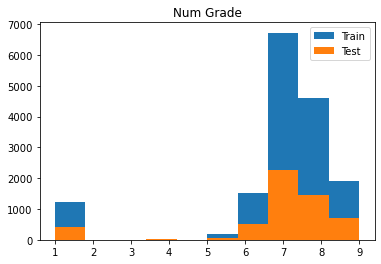

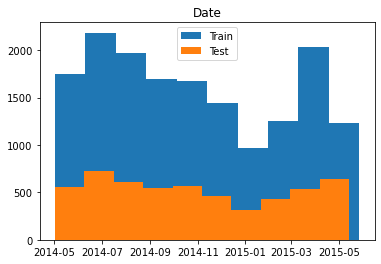

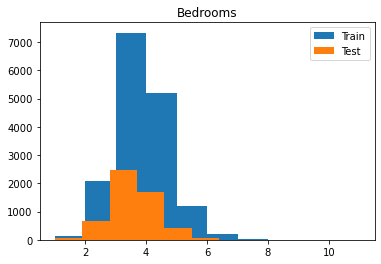

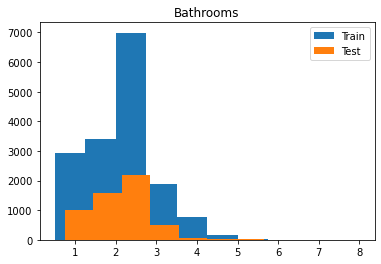

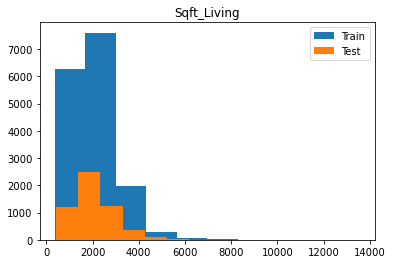

...

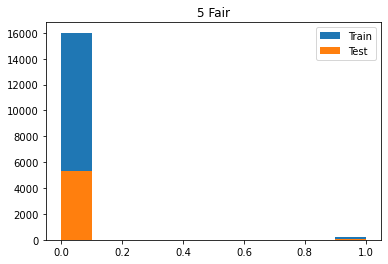

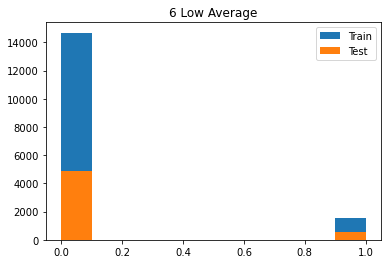

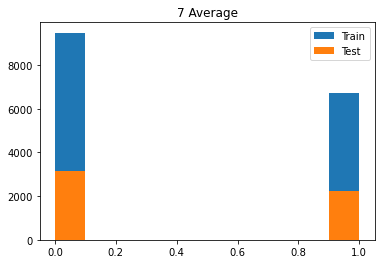

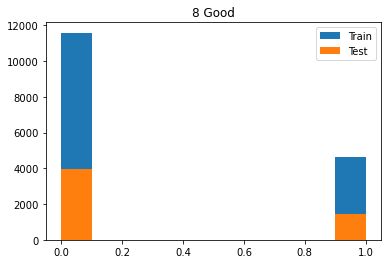

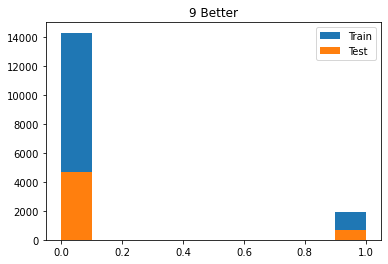

In [62]:
used_cols = [c for c in df_limited.columns if c not in ['price']]

for col in used_cols:
    plt.hist(X_train[col], label = 'Train')
    plt.hist(X_test[col], label = 'Test')
    plt.title(f"{col.title()}")
    plt.legend()
    plt.show()

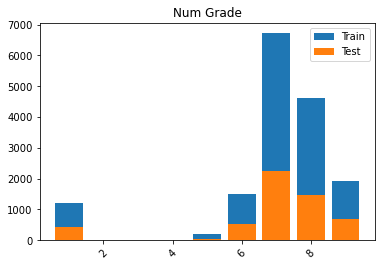

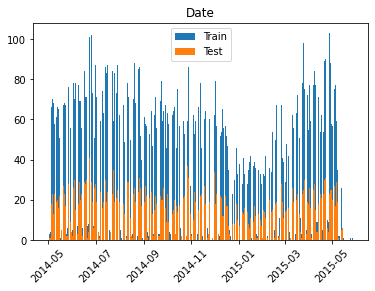

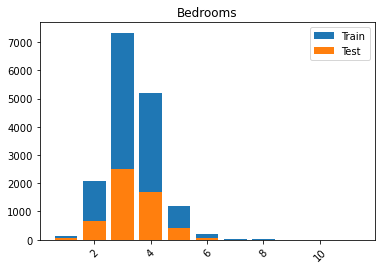

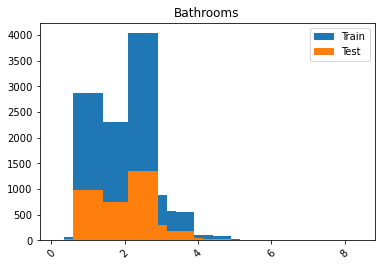

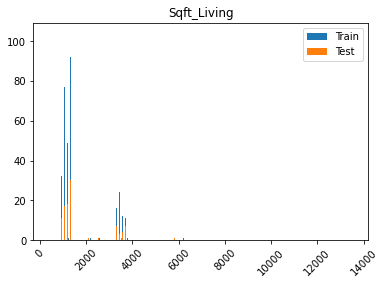

...

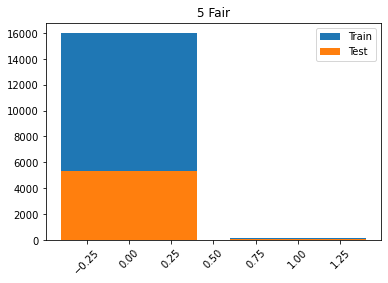

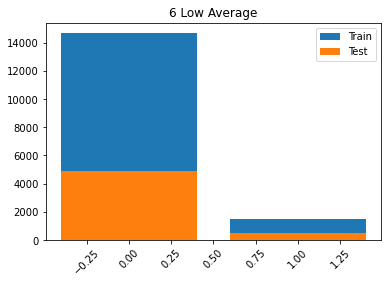

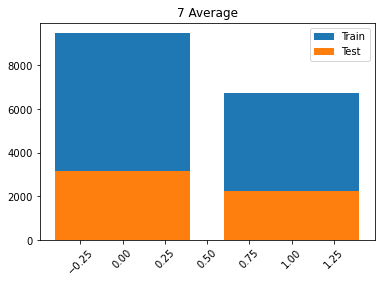

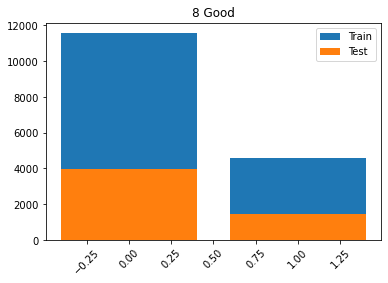

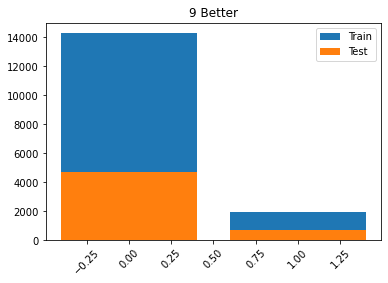

In [66]:
for col in used_cols:
    train_values = X_train[col].value_counts()
    test_values = X_test[col].value_counts()
    plt.bar(train_values.index, train_values, label = 'Train')
    plt.bar(test_values.index, test_values, label = 'Test')
    plt.title(f"{col.title()}")
    plt.xticks(rotation = 45)
    plt.legend()
    plt.show()

In [67]:
df_limited.corr()

,num grade,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,yr_built,...,11 Excellent,12 Luxury,13 Mansion,3 Poor,4 Low,5 Fair,6 Low Average,7 Average,8 Good,9 Better
num grade,1.000000,-0.340626,-0.035810,-0.125662,-0.273915,-0.086174,-0.008033,-0.274295,-0.055201,0.031072,...,-0.427781,-0.200575,-0.076522,-0.014083,-0.054676,-0.108709,-0.160423,0.022962,0.344596,0.399248
price,-0.340626,1.000000,0.315961,0.525915,0.701929,0.089879,0.256820,0.605392,0.323794,0.053965,...,0.357592,0.291070,0.211807,-0.005155,-0.031617,-0.084548,-0.209460,-0.316079,0.004584,0.235864
bedrooms,-0.035810,0.315961,1.000000,0.527870,0.593178,0.033602,0.183707,0.492543,0.309261,0.160736,...,0.119668,0.063883,0.040022,-0.017852,-0.069629,-0.115794,-0.244886,-0.109168,0.075885,0.164795
bathrooms,-0.125662,0.525915,0.527870,1.000000,0.755755,0.088368,0.502574,0.686664,0.283459,0.507166,...,0.247291,0.159733,0.095118,-0.012087,-0.055600,-0.138743,-0.366195,-0.313442,0.189415,0.264750
sqft_living,-0.273915,0.701929,0.593178,0.755755,1.000000,0.173449,0.353941,0.876448,0.435152,0.318140,...,0.345963,0.238136,0.144424,-0.011565,-0.053936,-0.127201,-0.312496,-0.358901,0.071101,0.318493
sqft_lot,-0.086174,0.089879,0.033602,0.088368,0.173449,1.000000,-0.004824,0.184134,0.015424,0.052939,...,0.077103,0.061699,0.007766,-0.000348,0.000440,0.022930,-0.019120,-0.067781,-0.023930,0.049642
floors,-0.008033,0.256820,0.183707,0.502574,0.353941,-0.004824,1.000000,0.523970,-0.245694,0.489175,...,0.118732,0.054274,0.021257,-0.006231,-0.029966,-0.080352,-0.230547,-0.308212,0.201168,0.244174
sqft_above,-0.274295,0.605392,0.492543,0.686664,0.876448,0.184134,0.523970,1.000000,-0.052130,0.424017,...,0.342199,0.222179,0.126667,-0.010429,-0.047672,-0.108549,-0.280780,-0.387226,0.059398,0.343380
sqft_basement,-0.055201,0.323794,0.309261,0.283459,0.435152,0.015424,-0.245694,-0.052130,1.000000,-0.133043,...,0.077656,0.078447,0.062683,-0.004484,-0.022724,-0.060842,-0.123093,-0.020294,0.036397,0.018475
yr_built,0.031072,0.053965,0.160736,0.507166,0.318140,0.052939,0.489175,0.424017,-0.133043,1.000000,...,0.098758,0.046873,0.004691,-0.011815,-0.041845,-0.128821,-0.313518,-0.211931,0.199825,0.220094


In [68]:
df_limited['num grade'].value_counts()

7    8973
8    6065
9    2615
6    2038
1    1635
5     242
4      27
3       1
Name: num grade, dtype: int64

In [77]:
df_limited['num grade'].describe()

count    21596.000000
mean         6.948046
std          1.907707
min          1.000000
25%          7.000000
50%          7.000000
75%          8.000000
max          9.000000
Name: num grade, dtype: float64

In [69]:
df_limited['bedrooms'].value_counts()

3     9824
4     6882
2     2760
5     1601
6      272
1      196
7       38
8       13
9        6
10       3
11       1
Name: bedrooms, dtype: int64

In [71]:
df_limited['floors'].value_counts()

1.0    10672
2.0     8235
1.5     1910
3.0      611
2.5      161
3.5        7
Name: floors, dtype: int64

In [70]:
df_limited['month_date'].value_counts()

5     2414
4     2229
7     2211
6     2177
8     1939
10    1876
3     1875
9     1771
12    1470
11    1409
2     1247
1      978
Name: month_date, dtype: int64

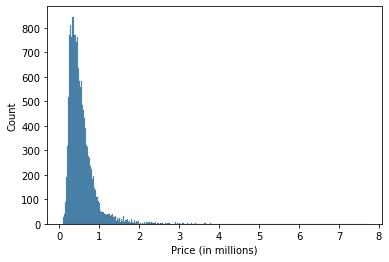

In [72]:
sns.histplot(y_train/1000000)
plt.xlabel('Price (in millions)');

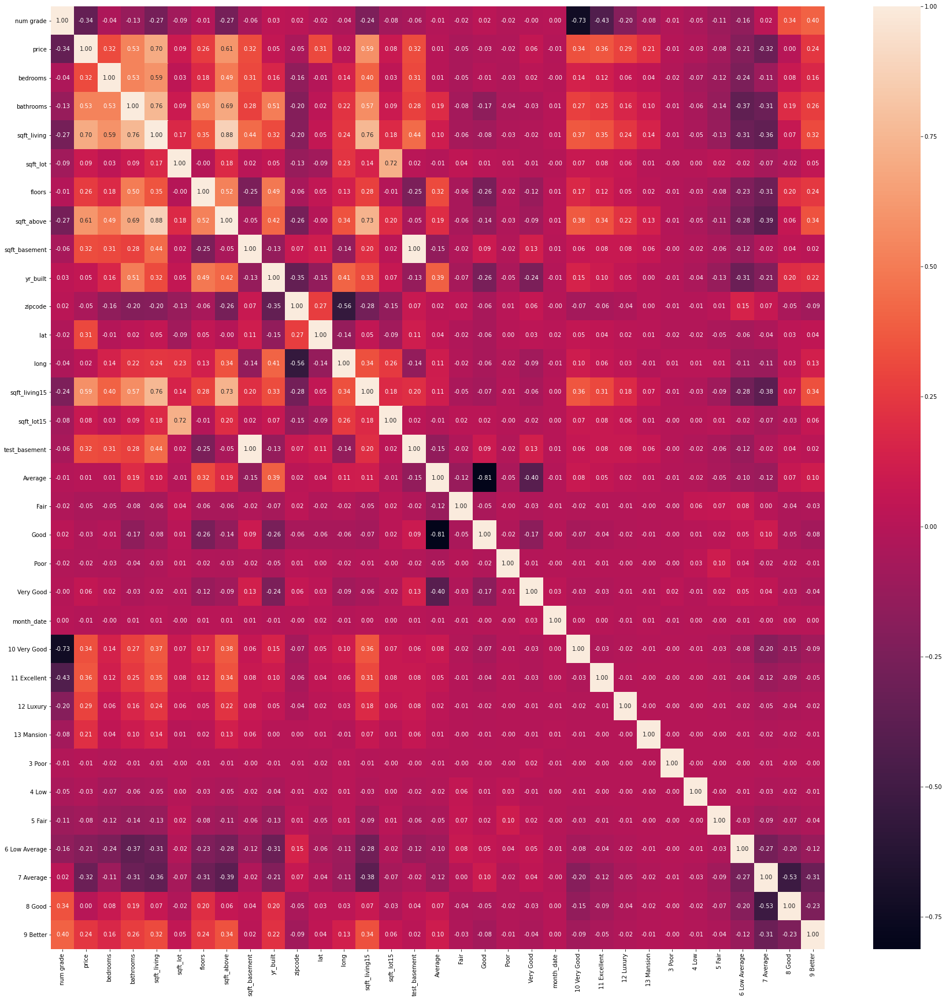

In [75]:
plt.figure(figsize = (30,30))
sns.heatmap(df_limited.corr(), annot = True, fmt = '.2f');

In [78]:
avg_price_zipcode = df.groupby('zipcode')['price'].mean().round(2)df_zip_price = pd.DataFrame()
df_zip_price['zipcode'] = avg_price_zipcode.index
df_zip_price['mean_price'] = avg_price_zipcode.values
df_zip_price['zipcode'] = df_zip_price[“zipcode”].astype(str)
import folium
map = folium.Map(location = [47.56,-122.26],default_zoom_start = .5)
map.choropleth(geo_data=“../../data/kc_zipcodes.geojson”,data = df_zip_price, columns = [‘zipcode’,‘mean_price’],key_on=‘feature.properties.ZIPCODE’,fill_color= “BuPu”, fill_opacity =0.7,line_opacity=0.2,legend_name = ‘MEAN SALE PRICE’)
map

SyntaxError: invalid syntax (<ipython-input-78-36f80a5e8aa1>, line 1)

In [81]:

!pip install pandas_profiling
from pandas_profiling import ProfileReport


  Using cached pandas_profiling-3.1.0-py2.py3-none-any.whl (261 kB)
  Using cached joblib-1.0.1-py3-none-any.whl (303 kB)
Processing c:\users\jenny\appdata\local\pip\cache\wheels\23\14\6e\4be5bfeeb027f4939a01764b48edd5996acf574b0913fe5243\htmlmin-0.1.12-py3-none-any.whl
  Using cached visions-0.7.4-py3-none-any.whl (102 kB)
  Using cached phik-0.12.0-cp38-cp38-win_amd64.whl (659 kB)
  Using cached multimethod-1.6-py3-none-any.whl (9.4 kB)
  Using cached pydantic-1.8.2-cp38-cp38-win_amd64.whl (2.0 MB)
  Using cached tangled_up_in_unicode-0.1.0-py3-none-any.whl (3.1 MB)
Processing c:\users\jenny\appdata\local\pip\cache\wheels\48\a1\7f\096c1269d6bf78d4768180602579b35a1e8cb1250bb4b40c74\imagehash-4.2.1-py2.py3-none-any.whl
  Using cached PyWavelets-1.1.1-cp38-cp38-win_amd64.whl (4.3 MB)
  Attempting uninstall: joblib
    Found existing installation: joblib 0.17.0
    Uninstalling joblib-0.17.0:
      Successfully uninstalled joblib-0.17.0


ERROR: After October 2020 you may experience errors when installing or updating packages. This is because pip will change the way that it resolves dependency conflicts.

We recommend you use --use-feature=2020-resolver to test your packages with the new resolver before it becomes the default.

phik 0.12.0 requires scipy>=1.5.2, but you'll have scipy 1.5.0 which is incompatible.


In [82]:
df_report = df.profile_report(title="Housing Dataset", sort = None)
df_report

In [85]:
df.loc[df['yr_built'].max()]

date             2014-11-18 00:00:00
price                         580000
bedrooms                           3
bathrooms                       3.25
sqft_living                     1490
sqft_lot                         857
floors                             3
grade                         8 Good
sqft_above                      1220
sqft_basement                    270
yr_built                        2001
zipcode                        98102
lat                          47.6357
long                        -122.324
sqft_living15                   1550
sqft_lot15                      1092
test_basement                    270
Average                            1
Fair                               0
Good                               0
Poor                               0
Very Good                          0
Name: 2015, dtype: object

In [45]:
# code here to prepare your data

## Modeling

Describe and justify the process for analyzing or modeling the data.

Questions to consider:

- How did you analyze the data to arrive at an initial approach?
- How did you iterate on your initial approach to make it better?
- Why are these choices appropriate given the data and the business problem?

## Evaluation

The evaluation of each model should accompany the creation of each model, and you should be sure to evaluate your models consistently.

Evaluate how well your work solves the stated business problem. 

Questions to consider:

- How do you interpret the results?
- How well does your model fit your data? How much better is this than your baseline model? Is it over or under fit?
- How well does your model/data fit any modeling assumptions?

For the final model, you might also consider:

- How confident are you that your results would generalize beyond the data you have?
- How confident are you that this model would benefit the business if put into use?

### Baseline Understanding

- What does a baseline, model-less prediction look like?

In [46]:
# code here to arrive at a baseline prediction

### First $&(@# Model

Before going too far down the data preparation rabbit hole, be sure to check your work against a first 'substandard' model! What is the easiest way for you to find out how hard your problem is?

In [47]:
# code here for your first 'substandard' model

In [48]:
# code here to evaluate your first 'substandard' model

### Modeling Iterations

Now you can start to use the results of your first model to iterate - there are many options!

In [49]:
# code here to iteratively improve your models

In [50]:
# code here to evaluate your iterations

### 'Final' Model

In the end, you'll arrive at a 'final' model - aka the one you'll use to make your recommendations/conclusions. This likely blends any group work. It might not be the one with the highest scores, but instead might be considered 'final' or 'best' for other reasons.

In [51]:
# code here to show your final model

In [52]:
# code here to evaluate your final model

## Conclusions

Provide your conclusions about the work you've done, including any limitations or next steps.

Questions to consider:

- What would you recommend the business do as a result of this work?
- What are some reasons why your analysis might not fully solve the business problem?
- What else could you do in the future to improve this project (future work)?
